In [ ]:
from google.colab import drive
drive.mount("/content/drive")

Mounted at /content/drive


In [ ]:
!pip install pyspellchecker
!pip install fasttext
!pip install langdetect
!pip install texthero
!pip install transformers
!pip install vaderSentiment
!pip install pyLDAvis
!pip install scattertext

     |████████████████████████████████| 1.9MB 9.2MB/s 
     |████████████████████████████████| 71kB 4.5MB/s 
  Created wheel for fasttext: filename=fasttext-0.9.2-cp36-cp36m-linux_x86_64.whl size=3041180 sha256=24a9b80742c5612abf72e9e146fceb2a771510d76d1da81da559989d363b2003
  Stored in directory: /root/.cache/pip/wheels/98/ba/7f/b154944a1cf5a8cee91c154b75231136cc3a3321ab0e30f592
Successfully built fasttext
     |████████████████████████████████| 983kB 8.9MB/s 
  Created wheel for langdetect: filename=langdetect-1.0.8-cp36-none-any.whl size=993195 sha256=cd3da416da4cc26e748b5327d5607563b42ce7f29a80e3f7e17f6bdea8f7c7d2
  Stored in directory: /root/.cache/pip/wheels/8d/b3/aa/6d99de9f3841d7d3d40a60ea06e6d669e8e5012e6c8b947a57
Successfully built langdetect
     |████████████████████████████████| 1.4MB 13.0MB/s 
     |████████████████████████████████| 245kB 44.0MB/s 
  Created wheel for nltk: filename=nltk-3.5-cp36-none-any.whl size=1434678 sha256=07964799e75a0f4958d862eeabf20a0e5bc474db599

In [ ]:

#Python Imports
import re
import string
from collections import Counter
from datetime import datetime
from IPython.display import IFrame
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:98% !important; }</style>"))


#Pandas
import pandas as pd
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns',120)

#Seaborn
import seaborn as sns

#Numpy
import numpy as np

#NLTK
import nltk
from nltk.stem import WordNetLemmatizer
nltk.download('wordnet')
nltk.download('stopwords')  
from nltk.corpus import stopwords

#spaCy
import spacy

#Visualization
import matplotlib.pyplot as plt 
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
import scattertext as st

#fasttext

import fasttext
from spellchecker import SpellChecker


#LDA Related packages
import langdetect
import texthero as hero
import regex as re
import math
from transformers import pipeline

import gensim
from gensim.utils import simple_preprocess
from gensim import corpora
from gensim.models import LdaModel
from gensim.models.coherencemodel import CoherenceModel

# LDA visualization
import pyLDAvis
import pyLDAvis.gensim  
import matplotlib.pyplot as plt

#Sentiment
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer


[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Unzipping corpora/wordnet.zip.
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


In [ ]:

df = pd.read_csv("/content/drive/Shared drives/NLP/Project/twcs2.csv", low_memory=False)

# A. Reformatting Dataframe
- Matching tweet to company
- Splitting tweets into inbound tweets (from customers), company tweets, and customer response tweets.

Here we gather all twitter complaint conversations from 2 tweets (inbound and company response), to 4 tweets (inbound and 3 company responses). We do this because sometimes the company might not respond directly to the inbound tweet, so we save longer twitter conversations in order to have a better chance of labelling each tweet with a company.

In [ ]:
#code results in inbound tweet, and 3 responding tweets, as well as companies
df_resp = df[['created_at','tweet_id','author_id','text','in_response_to_tweet_id', 'response_tweet_id']]

# 1. Gathering all inbound tweets(from customers) and all its first responses by merging left.
inbound = df[pd.isnull(df.in_response_to_tweet_id) & df.inbound == True]
inbound = inbound[['created_at','tweet_id','text','response_tweet_id', 'in_response_to_tweet_id']]
df2 = pd.merge(inbound, df_resp, how = 'left', left_on='tweet_id', right_on='in_response_to_tweet_id')
df2 = df2[['created_at_x','text_x', 'tweet_id_y','author_id','created_at_y','text_y']]

# 2. Gathering all responses to the 'first responses'.
df3 = pd.merge(df2, df_resp, how = 'left', left_on='tweet_id_y', right_on='in_response_to_tweet_id')
df3 = df3[['created_at_x', 'text_x','author_id_x', 'created_at_y', 'text_y','created_at','tweet_id', 'author_id_y','text']]
df3.rename(columns={'created_at_x':'inbound_time','text_x': 'inbound_text', 'author_id_x': 'author_1','created_at_y':'resp_1_time', 'text_y' : 'text1',\
                   'author_id_y':'author_2', 'created_at':'resp_2_time', 'text':'text2'}, inplace=True)

# 2b. Since some conversations end within 2 tweets (inbound and response), the third tweet will be null. So we save these 2 tweet
# conversations into a dataframe called first_resp.
first_resp = df3[df3.tweet_id.isnull()]
first_resp.rename(columns = {'author_1': 'company'}, inplace = True)
first_resp = first_resp.iloc[:,:-4]

# 3. Gathering all third responses to second response column.
df3 = df3[df3.tweet_id.notnull()]
df4 = pd.merge(df3, df_resp, how = 'left', left_on='tweet_id', right_on='in_response_to_tweet_id')
df4 = df4[['inbound_time','inbound_text','author_1','resp_1_time', 'text1','resp_2_time',\
           'author_2','text2','created_at', 'tweet_id_y','author_id','text']]
df4.rename(columns = {'author_id': 'author_3', 'text':'text3', 'created_at': 'resp_3_time'},inplace = True)

# 3b. If the conversation ends within 3 tweets (inbound and 2 responses), we will save that to antoher dataframe called 2nd response.
second_resp = df4[df4.tweet_id_y.isnull()]
second_resp = second_resp.iloc[:,:-4]
second_resp['company'] = ''
for count in second_resp.index:
    for i in ['author_1','author_2']:
        if second_resp[i][count].isnumeric() == False:
            second_resp['company'][count] = second_resp[i][count]

# 4. Gathering all fourth responses to third response column.
df4 = df4[df4.tweet_id_y.notnull()]
df5 = pd.merge(df4, df_resp, how = 'left', left_on='tweet_id_y', right_on='in_response_to_tweet_id')
df5 = df5[['inbound_time','inbound_text','author_1','resp_1_time', 'text1','author_2', 'resp_2_time', 'text2','author_3','resp_3_time', 'text3',\
          'author_id','created_at', 'text','tweet_id']]
df5.rename(columns = {'author_id': 'author_4', 'created_at':'resp_4_time', 'text':'text4'},inplace = True)

# 3b. If the conversation ends within 4 tweets (inbound and 3 responses), we will save that to antoher dataframe called 2nd response.
third_resp = df5[df5.tweet_id.isnull()]
third_resp = third_resp.iloc[:,:-4]
third_resp['company'] = ''
for count in third_resp.index:
    for i in ['author_1','author_2','author_3']:
        if third_resp[i][count].isnumeric() == False:
            third_resp['company'][count] = third_resp[i][count]

Creating a dataframe with all labelled inbound, company and responding tweets. Labelling each tweet with related company.

In [ ]:
# Creating a dataframe with company, text and tweet type.

inbound1 = pd.concat([first_resp[['inbound_time','inbound_text','company']], second_resp[['inbound_time','inbound_text','company']]\
          ,third_resp[['inbound_time','inbound_text','company']]])
inbound1.rename(columns = {'inbound_text':'text', 'inbound_time':'time'}, inplace = True)
inbound1['type'] = 'inbound'

comp_tweet0 = first_resp[['resp_1_time','company','text1']]
comp_tweet0.rename(columns = {'text1':'text', 'resp_1_time':'time'}, inplace = True)

comp_tweet1 = second_resp[second_resp.author_1.apply(lambda x: x.isnumeric()== False)][['resp_1_time','company','text1']]
comp_tweet1.rename(columns = {'text1':'text','resp_1_time':'time'}, inplace = True)
comp_tweet2 = second_resp[second_resp.author_2.apply(lambda x: x.isnumeric()== False)][['resp_2_time','company','text2']]
comp_tweet2.rename(columns = {'text2':'text', 'resp_2_time':'time'}, inplace = True)

comp_tweet3 = third_resp[third_resp.author_1.apply(lambda x: x.isnumeric()== False)][['resp_1_time', 'company','text1']]
comp_tweet3.rename(columns = {'text1':'text', 'resp_1_time':'time'}, inplace = True)
comp_tweet4 = third_resp[third_resp.author_2.apply(lambda x: x.isnumeric()== False)][['resp_2_time', 'company','text2']]
comp_tweet4.rename(columns = {'text2':'text','resp_2_time':'time'}, inplace = True)
comp_tweet5 = third_resp[third_resp.author_3.apply(lambda x: x.isnumeric()== False)][['resp_3_time', 'company','text3']]
comp_tweet5.rename(columns = {'text3':'text', 'resp_3_time':'time'}, inplace = True)

company = pd.concat([comp_tweet0, comp_tweet1, comp_tweet2, comp_tweet3, comp_tweet4, comp_tweet5])
company['type'] = 'company'


resp_tweet1 = second_resp[second_resp.author_1.apply(lambda x: x.isnumeric())][['resp_1_time','company','text1']]
resp_tweet1.rename(columns = {'text1':'text','resp_1_time':'time'}, inplace = True)
resp_tweet2 = second_resp[second_resp.author_2.apply(lambda x: x.isnumeric())][['resp_2_time', 'company','text2']]
resp_tweet2.rename(columns = {'text2':'text','resp_2_time':'time'}, inplace = True)
resp_tweet3 = third_resp[third_resp.author_1.apply(lambda x: x.isnumeric())][['resp_1_time','company','text1']]
resp_tweet3.rename(columns = {'text1':'text','resp_1_time':'time'}, inplace = True)
resp_tweet4 = third_resp[third_resp.author_2.apply(lambda x: x.isnumeric())][['resp_2_time', 'company','text2']]
resp_tweet4.rename(columns = {'text2':'text','resp_2_time':'time'}, inplace = True)
resp_tweet5 = third_resp[third_resp.author_3.apply(lambda x: x.isnumeric())][['resp_3_time', 'company','text3']]
resp_tweet5.rename(columns = {'text3':'text','resp_3_time':'time'}, inplace = True)

responses = pd.concat([resp_tweet1, resp_tweet2, resp_tweet3, resp_tweet4, resp_tweet5])
responses['type'] = 'responses'

In [ ]:
preprocessed = pd.concat([inbound1, company, responses])
df = preprocessed.copy()

Since there may be multiple tweets responding to the initial inbound tweet, there may be multiple of the same inbound tweets included in the dataframe. We will only keep the unique tweets in the dataframe.
- We have a total of 1,929,658 unique tweets.

In [ ]:
# Keeping unique tweet values
a, indeces = np.unique(df.text, return_index= True)
indeces.sort()
df = df.iloc[indeces]

In [ ]:
df.head()

,time,text,company,type
2,Tue Oct 31 21:45:10 +0000 2017,@sprintcare is the worst customer service,sprintcare,inbound
5,Tue Oct 31 22:03:34 +0000 2017,"@115714 whenever I contact customer support, t...",sprintcare,inbound
7,Tue Oct 31 22:06:54 +0000 2017,"Yo @Ask_Spectrum, your customer service reps a...",Ask_Spectrum,inbound
8,Tue Oct 31 22:06:56 +0000 2017,My picture on @Ask_Spectrum pretty much every ...,Ask_Spectrum,inbound
10,Tue Oct 31 22:12:16 +0000 2017,@VerizonSupport My friend is without internet ...,VerizonSupport,inbound


In [ ]:
df_emoji = df.copy()

# B. Data Cleaning / Preprocessing

In [ ]:
chat_words = {
    "AFAIK": "As Far As I Know",
    "AFK": "Away From Keyboard",
    "ASAP": "As Soon As Possible",
    "ATK": "At The Keyboard",
    "ATM": "At The Moment",
    "A3": "Anytime, Anywhere, Anyplace",
    "BAK": "Back At Keyboard",
    "BBL": "Be Back Later",
    "BBS": "Be Back Soon",
    "BFN": "Bye For Now",
    "B4N": "Bye For Now",
    "BRB": "Be Right Back",
    "BRT": "Be Right There",
    "BTW": "By The Way",
    "B4": "Before",
    "B4N": "Bye For Now",
    "CU": "See You",
    "CUL8R": "See You Later",
    "CYA": "See You",
    "FAQ": "Frequently Asked Questions",
    "FC": "Fingers Crossed",
    "FWIW": "For What It's Worth",
    "FYI": "For Your Information",
    "GAL": "Get A Life",
    "GG": "Good Game",
    "GN": "Good Night",
    "GMTA": "Great Minds Think Alike",
    "GR8": "Great!",
    "G9": "Genius",
    "IC": "I See",
    "ICQ": "I Seek you (also a chat program)",
    "ILU": "ILU: I Love You",
    "IMHO": "In My Honest/Humble Opinion",
    "IMO": "In My Opinion",
    "IOW": "In Other Words",
    "IRL": "In Real Life",
    "KISS": "Keep It Simple, Stupid",
    "LDR": "Long Distance Relationship",
    "LMAO": "Laugh My A.. Off",
    "LOL": "Laughing Out Loud",
    "LTNS": "Long Time No See",
    "L8R": "Later",
    "MTE": "My Thoughts Exactly",
    "M8": "Mate",
    "NRN": "No Reply Necessary",
    "OIC": "Oh I See",
    "PITA": "Pain In The A..",
    "PRT": "Party",
    "PRW": "Parents Are Watching",
    "ROFL": "Rolling On The Floor Laughing",
    "ROFLOL": "Rolling On The Floor Laughing Out Loud",
    "ROTFLMAO": "Rolling On The Floor Laughing My Ass Off",
    "SK8": "Skate",
    "STATS": "Your sex and age",
    "ASL": "Age, Sex, Location",
    "THX": "Thank You",
    "TTFN": "Ta-Ta For Now!",
    "TTYL": "Talk To You Later",
    "U": "You",
    "U2": "You Too",
    "U4E": "Yours For Ever",
    "WB": "Welcome Back",
    "WTF": "What The F...",
    "WTG": "Way To Go!",
    "WUF": "Where Are You From?",
    "W8": "Wait",
    "IMMA": "I am going to",
    "2NITE": "tonight",
    "DMED": "mesaged",
    'DM': "message",
    "SMH": "I am dissapointed"
}

# Thanks to https://stackoverflow.com/a/43023503/3971619
contractions = {
    "ain't": "are not",
    "aren't": "are not",
    "can't": "cannot",
    "can't've": "cannot have",
    "'cause": "because",
    "could've": "could have",
    "couldn't": "could not",
    "couldn't've": "could not have",
    "didn't": "did not",
    "doesn't": "does not",
    "don't": "do not",
    "hadn't": "had not",
    "hadn't've": "had not have",
    "hasn't": "has not",
    "haven't": "have not",
    "he'd": "he would",
    "he'd've": "he would have",
    "he'll": "he will",
    "he'll've": "he shall have / he will have",
    "he's": "he is",
    "how'd": "how did",
    "how'd'y": "how do you",
    "how'll": "how will",
    "how's": "how is",
    "i'd": "I would",
    "i'd've": "I would have",
    "i'll": "I will",
    "i'll've": "I will have",
    "i'm": "I am",
    "i've": "I have",
    "isn't": "is not",
    "it'd": "it would",
    "it'd've": "it would have",
    "it'll": "it will",
    "it'll've": "it will have",
    "it's": "it is",
    "let's": "let us",
    "ma'am": "madam",
    "mayn't": "may not",
    "might've": "might have",
    "mightn't": "might not",
    "mightn't've": "might not have",
    "must've": "must have",
    "mustn't": "must not",
    "mustn't've": "must not have",
    "needn't": "need not",
    "needn't've": "need not have",
    "o'clock": "of the clock",
    "oughtn't": "ought not",
    "oughtn't've": "ought not have",
    "shan't": "shall not",
    "sha'n't": "shall not",
    "shan't've": "shall not have",
    "she'd": "she would",
    "she'd've": "she would have",
    "she'll": "she will",
    "she'll've": "she will have",
    "she's": "she is",
    "should've": "should have",
    "shouldn't": "should not",
    "shouldn't've": "should not have",
    "so've": "so have",
    "so's": "so is",
    "that'd": "that had",
    "that'd've": "that would have",
    "that's": "that is",
    "there'd": "there would",
    "there'd've": "there would have",
    "there's": "there is",
    "they'd": "they would",
    "they'd've": "they would have",
    "they'll": "they will",
    "they're": "they are",
    "they've": "they have",
    "to've": "to have",
    "wasn't": "was not",
    "we'd": "we would",
    "we'd've": "we would have",
    "we'll": "we will",
    "we'll've": "we will have",
    "we're": "we are",
    "we've": "we have",
    "weren't": "were not",
    "what'll": "what will",
    "what're": "what are",
    "what's": "what is",
    "what've": "what have",
    "when's": "when is",
    "when've": "when have",
    "where'd": "where did",
    "where's": "where is",
    "where've": "where have",
    "who'll": "who will",
    "who's": "who is",
    "who've": "who have",
    "why's": "why is",
    "why've": "why have",
    "will've": "will have",
    "won't": "will not",
    "won't've": "will not have",
    "would've": "would have",
    "wouldn't": "would not",
    "wouldn't've": "would not have",
    "y'all": "you all",
    "y'all'd": "you all would",
    "y'all'd've": "you all would have",
    "y'all're": "you all are",
    "y'all've": "you all have",
    "you'll": "you will",
    "you're": "you are",
    "you've": "you have",
}

# credits: https://github.com/NeelShah18/emot/blob/master/emot/emo_unicode.py
EMOTICONS = {
    u":‑\)":"Happy face or smiley",
    u":\)":"Happy face or smiley",
    u":-\]":"Happy face or smiley",
    u":\]":"Happy face or smiley",
    u":-3":"Happy face smiley",
    u":3":"Happy face smiley",
    u":->":"Happy face smiley",
    u":>":"Happy face smiley",
    u"8-\)":"Happy face smiley",
    u":o\)":"Happy face smiley",
    u":-\}":"Happy face smiley",
    u":\}":"Happy face smiley",
    u":-\)":"Happy face smiley",
    u":c\)":"Happy face smiley",
    u":\^\)":"Happy face smiley",
    u"=\]":"Happy face smiley",
    u"=\)":"Happy face smiley",
    u":‑D":"Laughing, big grin or laugh with glasses",
    u":D":"Laughing, big grin or laugh with glasses",
    u"8‑D":"Laughing, big grin or laugh with glasses",
    u"8D":"Laughing, big grin or laugh with glasses",
    u"X‑D":"Laughing, big grin or laugh with glasses",
    u"XD":"Laughing, big grin or laugh with glasses",
    u"=D":"Laughing, big grin or laugh with glasses",
    u"=3":"Laughing, big grin or laugh with glasses",
    u"B\^D":"Laughing, big grin or laugh with glasses",
    u":-\)\)":"Very happy",
    u":‑\(":"Frown, sad, andry or pouting",
    u":-\(":"Frown, sad, andry or pouting",
    u":\(":"Frown, sad, andry or pouting",
    u":‑c":"Frown, sad, andry or pouting",
    u":c":"Frown, sad, andry or pouting",
    u":‑<":"Frown, sad, andry or pouting",
    u":<":"Frown, sad, andry or pouting",
    u":‑\[":"Frown, sad, andry or pouting",
    u":\[":"Frown, sad, andry or pouting",
    u":-\|\|":"Frown, sad, andry or pouting",
    u">:\[":"Frown, sad, andry or pouting",
    u":\{":"Frown, sad, andry or pouting",
    u":@":"Frown, sad, andry or pouting",
    u">:\(":"Frown, sad, andry or pouting",
    u":'‑\(":"Crying",
    u":'\(":"Crying",
    u":'‑\)":"Tears of happiness",
    u":'\)":"Tears of happiness",
    u"D‑':":"Horror",
    u"D:<":"Disgust",
    u"D:":"Sadness",
    u"D8":"Great dismay",
    u"D;":"Great dismay",
    u"D=":"Great dismay",
    u"DX":"Great dismay",
    u":‑O":"Surprise",
    u":O":"Surprise",
    u":‑o":"Surprise",
    u":o":"Surprise",
    u":-0":"Shock",
    u"8‑0":"Yawn",
    u">:O":"Yawn",
    u":-\*":"Kiss",
    u":\*":"Kiss",
    u":X":"Kiss",
    u";‑\)":"Wink or smirk",
    u";\)":"Wink or smirk",
    u"\*-\)":"Wink or smirk",
    u"\*\)":"Wink or smirk",
    u";‑\]":"Wink or smirk",
    u";\]":"Wink or smirk",
    u";\^\)":"Wink or smirk",
    u":‑,":"Wink or smirk",
    u";D":"Wink or smirk",
    u":‑P":"Tongue sticking out, cheeky, playful or blowing a raspberry",
    u":P":"Tongue sticking out, cheeky, playful or blowing a raspberry",
    u"X‑P":"Tongue sticking out, cheeky, playful or blowing a raspberry",
    u"XP":"Tongue sticking out, cheeky, playful or blowing a raspberry",
    u":‑Þ":"Tongue sticking out, cheeky, playful or blowing a raspberry",
    u":Þ":"Tongue sticking out, cheeky, playful or blowing a raspberry",
    u":b":"Tongue sticking out, cheeky, playful or blowing a raspberry",
    u"d:":"Tongue sticking out, cheeky, playful or blowing a raspberry",
    u"=p":"Tongue sticking out, cheeky, playful or blowing a raspberry",
    u">:P":"Tongue sticking out, cheeky, playful or blowing a raspberry",
    u":‑/":"Skeptical, annoyed, undecided, uneasy or hesitant",
    u":/":"Skeptical, annoyed, undecided, uneasy or hesitant",
    u":-[.]":"Skeptical, annoyed, undecided, uneasy or hesitant",
    u">:[(\\\)]":"Skeptical, annoyed, undecided, uneasy or hesitant",
    u">:/":"Skeptical, annoyed, undecided, uneasy or hesitant",
    u":[(\\\)]":"Skeptical, annoyed, undecided, uneasy or hesitant",
    u"=/":"Skeptical, annoyed, undecided, uneasy or hesitant",
    u"=[(\\\)]":"Skeptical, annoyed, undecided, uneasy or hesitant",
    u":L":"Skeptical, annoyed, undecided, uneasy or hesitant",
    u"=L":"Skeptical, annoyed, undecided, uneasy or hesitant",
    u":S":"Skeptical, annoyed, undecided, uneasy or hesitant",
    u":‑\|":"Straight face",
    u":\|":"Straight face",
    u":$":"Embarrassed or blushing",
    u":‑x":"Sealed lips or wearing braces or tongue-tied",
    u":x":"Sealed lips or wearing braces or tongue-tied",
    u":‑#":"Sealed lips or wearing braces or tongue-tied",
    u":#":"Sealed lips or wearing braces or tongue-tied",
    u":‑&":"Sealed lips or wearing braces or tongue-tied",
    u":&":"Sealed lips or wearing braces or tongue-tied",
    u"O:‑\)":"Angel, saint or innocent",
    u"O:\)":"Angel, saint or innocent",
    u"0:‑3":"Angel, saint or innocent",
    u"0:3":"Angel, saint or innocent",
    u"0:‑\)":"Angel, saint or innocent",
    u"0:\)":"Angel, saint or innocent",
    u":‑b":"Tongue sticking out, cheeky, playful or blowing a raspberry",
    u"0;\^\)":"Angel, saint or innocent",
    u">:‑\)":"Evil or devilish",
    u">:\)":"Evil or devilish",
    u"\}:‑\)":"Evil or devilish",
    u"\}:\)":"Evil or devilish",
    u"3:‑\)":"Evil or devilish",
    u"3:\)":"Evil or devilish",
    u">;\)":"Evil or devilish",
    u"\|;‑\)":"Cool",
    u"\|‑O":"Bored",
    u":‑J":"Tongue-in-cheek",
    u"#‑\)":"Party all night",
    u"%‑\)":"Drunk or confused",
    u"%\)":"Drunk or confused",
    u":-###..":"Being sick",
    u":###..":"Being sick",
    u"<:‑\|":"Dump",
    u"\(>_<\)":"Troubled",
    u"\(>_<\)>":"Troubled",
    u"\(';'\)":"Baby",
    u"\(\^\^>``":"Nervous or Embarrassed or Troubled or Shy or Sweat drop",
    u"\(\^_\^;\)":"Nervous or Embarrassed or Troubled or Shy or Sweat drop",
    u"\(-_-;\)":"Nervous or Embarrassed or Troubled or Shy or Sweat drop",
    u"\(~_~;\) \(・\.・;\)":"Nervous or Embarrassed or Troubled or Shy or Sweat drop",
    u"\(-_-\)zzz":"Sleeping",
    u"\(\^_-\)":"Wink",
    u"\(\(\+_\+\)\)":"Confused",
    u"\(\+o\+\)":"Confused",
    u"\(o\|o\)":"Ultraman",
    u"\^_\^":"Joyful",
    u"\(\^_\^\)/":"Joyful",
    u"\(\^O\^\)／":"Joyful",
    u"\(\^o\^\)／":"Joyful",
    u"\(__\)":"Kowtow as a sign of respect, or dogeza for apology",
    u"_\(\._\.\)_":"Kowtow as a sign of respect, or dogeza for apology",
    u"<\(_ _\)>":"Kowtow as a sign of respect, or dogeza for apology",
    u"<m\(__\)m>":"Kowtow as a sign of respect, or dogeza for apology",
    u"m\(__\)m":"Kowtow as a sign of respect, or dogeza for apology",
    u"m\(_ _\)m":"Kowtow as a sign of respect, or dogeza for apology",
    u"\('_'\)":"Sad or Crying",
    u"\(/_;\)":"Sad or Crying",
    u"\(T_T\) \(;_;\)":"Sad or Crying",
    u"\(;_;":"Sad of Crying",
    u"\(;_:\)":"Sad or Crying",
    u"\(;O;\)":"Sad or Crying",
    u"\(:_;\)":"Sad or Crying",
    u"\(ToT\)":"Sad or Crying",
    u";_;":"Sad or Crying",
    u";-;":"Sad or Crying",
    u";n;":"Sad or Crying",
    u";;":"Sad or Crying",
    u"Q\.Q":"Sad or Crying",
    u"T\.T":"Sad or Crying",
    u"QQ":"Sad or Crying",
    u"Q_Q":"Sad or Crying",
    u"\(-\.-\)":"Shame",
    u"\(-_-\)":"Shame",
    u"\(一一\)":"Shame",
    u"\(；一_一\)":"Shame",
    u"\(=_=\)":"Tired",
    u"\(=\^\·\^=\)":"cat",
    u"\(=\^\·\·\^=\)":"cat",
    u"=_\^=	":"cat",
    u"\(\.\.\)":"Looking down",
    u"\(\._\.\)":"Looking down",
    u"\^m\^":"Giggling with hand covering mouth",
    u"\(\・\・?":"Confusion",
    u"\(?_?\)":"Confusion",
    u">\^_\^<":"Normal Laugh",
    u"<\^!\^>":"Normal Laugh",
    u"\^/\^":"Normal Laugh",
    u"\（\*\^_\^\*）" :"Normal Laugh",
    u"\(\^<\^\) \(\^\.\^\)":"Normal Laugh",
    u"\(^\^\)":"Normal Laugh",
    u"\(\^\.\^\)":"Normal Laugh",
    u"\(\^_\^\.\)":"Normal Laugh",
    u"\(\^_\^\)":"Normal Laugh",
    u"\(\^\^\)":"Normal Laugh",
    u"\(\^J\^\)":"Normal Laugh",
    u"\(\*\^\.\^\*\)":"Normal Laugh",
    u"\(\^—\^\）":"Normal Laugh",
    u"\(#\^\.\^#\)":"Normal Laugh",
    u"\（\^—\^\）":"Waving",
    u"\(;_;\)/~~~":"Waving",
    u"\(\^\.\^\)/~~~":"Waving",
    u"\(-_-\)/~~~ \($\·\·\)/~~~":"Waving",
    u"\(T_T\)/~~~":"Waving",
    u"\(ToT\)/~~~":"Waving",
    u"\(\*\^0\^\*\)":"Excited",
    u"\(\*_\*\)":"Amazed",
    u"\(\*_\*;":"Amazed",
    u"\(\+_\+\) \(@_@\)":"Amazed",
    u"\(\*\^\^\)v":"Laughing,Cheerful",
    u"\(\^_\^\)v":"Laughing,Cheerful",
    u"\(\(d[-_-]b\)\)":"Headphones,Listening to music",
    u'\(-"-\)':"Worried",
    u"\(ーー;\)":"Worried",
    u"\(\^0_0\^\)":"Eyeglasses",
    u"\(\＾ｖ\＾\)":"Happy",
    u"\(\＾ｕ\＾\)":"Happy",
    u"\(\^\)o\(\^\)":"Happy",
    u"\(\^O\^\)":"Happy",
    u"\(\^o\^\)":"Happy",
    u"\)\^o\^\(":"Happy",
    u":O o_O":"Surprised",
    u"o_0":"Surprised",
    u"o\.O":"Surpised",
    u"\(o\.o\)":"Surprised",
    u"oO":"Surprised",
    u"\(\*￣m￣\)":"Dissatisfied",
    u"\(‘A`\)":"Snubbed or Deflated"
}

<input>:192: DeprecationWarning:

invalid escape sequence \)

<input>:193: DeprecationWarning:

invalid escape sequence \)

<input>:194: DeprecationWarning:

invalid escape sequence \]

<input>:195: DeprecationWarning:

invalid escape sequence \]

<input>:200: DeprecationWarning:

invalid escape sequence \)

<input>:201: DeprecationWarning:

invalid escape sequence \)

<input>:202: DeprecationWarning:

invalid escape sequence \}

<input>:203: DeprecationWarning:

invalid escape sequence \}

<input>:204: DeprecationWarning:

invalid escape sequence \)

<input>:205: DeprecationWarning:

invalid escape sequence \)

<input>:206: DeprecationWarning:

invalid escape sequence \^

<input>:207: DeprecationWarning:

invalid escape sequence \]

<input>:208: DeprecationWarning:

invalid escape sequence \)

<input>:217: DeprecationWarning:

invalid escape sequence \^

<input>:218: DeprecationWarning:

invalid escape sequence \)

<input>:219: DeprecationWarning:

invalid escape sequence \(

<input>:

In [ ]:
len(df)

1929658

In [ ]:
df_pairwise = df

## Step 1 : Keep only English tweets

In [ ]:
len(df)

1929658

In [ ]:

PRETRAINED_MODEL_PATH = '/content/drive/Shared drives/NLP/Project/lid.176.bin'
model = fasttext.load_model(PRETRAINED_MODEL_PATH)
def isEnglish(string_):
    predictions = model.predict(string_)
    confidence_threshold = 0.85
    return ((predictions[0][0] == '__label__en') and (predictions[1][0] >= confidence_threshold))

In [ ]:
df['text'] = df['text'].apply(lambda x: re.sub('\n', '', x))
df = df[df['text'].apply(lambda x: isEnglish(x))]

## Step 2: Get Sentiment scores for each tweet

In [ ]:
sid_obj = SentimentIntensityAnalyzer() 
df['sent'] = df.text.apply(lambda y: sid_obj.polarity_scores(y)['compound'] )

## Step 3: Further Data Cleaning
- Remove mentions, punctions, Emojis, emoticons, URL's, HTML's, stopwords, and numbers.
- Lowercase
- Lemmatize
- Spellchecker

In [ ]:
df.head()

,time,text,company,type,sent
5,Tue Oct 31 22:03:34 +0000 2017,"@115714 whenever I contact customer support, t...",sprintcare,inbound,0.2144
8,Tue Oct 31 22:06:56 +0000 2017,My picture on @Ask_Spectrum pretty much every ...,Ask_Spectrum,inbound,0.4215
14,Tue Oct 31 21:56:55 +0000 2017,@115725 fix your app it won't even open,VerizonSupport,inbound,0.0000
17,Tue Oct 31 22:03:32 +0000 2017,@ChipotleTweets messed up today and didn’t giv...,ChipotleTweets,inbound,-0.6705
18,Tue Oct 31 22:03:06 +0000 2017,hey @ChipotleTweets wanna come to Mammoth. I'l...,ChipotleTweets,inbound,0.3182


In [ ]:
cnt = Counter()
for text in df["text"].values:
  for word in text.split():
    cnt[word] += 1
FREQWORDS = set([w for (w, wc) in cnt.most_common(10)])

In [ ]:
def transform_text(text, LDA_clean):

  # Preprocess Step 7: Remove Mentions
  text = ' '.join([w for w in text.split(' ') if not w.startswith('@')])

  # Preprocess Step 8: Remove Punctuation
  PUNCT_TO_REMOVE = string.punctuation
  def remove_punctuation(text):
      """custom function to remove the punctuation"""
      return text.translate(str.maketrans('', '', PUNCT_TO_REMOVE))
  text = remove_punctuation(text)

  # reference: https://www.kaggle.com/sudalairajkumar/getting-started-with-text-preprocessing
  # Pre-process Step 2 :Emoticons remove
  def remove_emoticons(text):
    pattern = re.compile(u'(' + u'|'.join(c for c in EMOTICONS) + u')')
    return pattern.sub(r'', text)
  #if LDA_clean == False:
  text = remove_emoticons(text)
    
  
  # Pre-process Step 3 : Emojis remove
  def remove_emoji(string):
    emoji_pattern = re.compile("["
                           u"\U0001F600-\U0001F64F"  # emoticons
                           u"\U0001F300-\U0001F5FF"  # symbols & pictographs
                           u"\U0001F680-\U0001F6FF"  # transport & map symbols
                           u"\U0001F1E0-\U0001F1FF"  # flags (iOS)
                           u"\U00002702-\U000027B0"
                           u"\U000024C2-\U0001F251"
                           "]+", flags=re.UNICODE)
    return emoji_pattern.sub(r'', string)
  text = remove_emoji(text)

  # Pre-process Step 4 : Chat slangs to full words      <- highlight it in presentation
  def remove_chat_words_and_contractions(string):
    new_text = []
    for word in string.split(' '):
        if word.upper() in chat_words.keys():
            new_text += chat_words[word.upper()].lower().split(' ')
        elif word.lower() in contractions.keys():
            new_text += contractions[word.lower()].split(' ')
        else:
            new_text.append(word)
    return ' '.join(new_text)
  text = remove_chat_words_and_contractions(text)

  # Preprocess Step 5 : Lowercasing
  text = text.lower()
  #df.text = df.text.apply(lambda x: lower(x))

  # Preprocess Step 6: Remove URL and HTML
  def remove_urls_HTML(text):
    url_pattern = re.compile(r'https?://\S+|www\.\S+')
    html_pattern = re.compile('<.*?>')
    text =  url_pattern.sub(r'', text)
    text = html_pattern.sub(r'', text)
    return text
  text = remove_urls_HTML(text)

  # Preprocess Step 9: Remove Stopwords
  STOPWORDS = set(stopwords.words('english'))
  def remove_stopwords(text):
    """custom function to remove the stopwords"""
    return " ".join([word for word in str(text).split() if word not in STOPWORDS])
  text = remove_stopwords(text)
 
  if LDA_clean == True:
    # Removing words less than 3 characters
    text = ' '.join([w for w in text.split() if len(w)>= 3])

  # Preprocess Step 10: Remove Top 10 frequent words
  def remove_freqwords(text):
    return " ".join([word for word in str(text).split() if word not in FREQWORDS])    
  text = remove_freqwords(text)

  # Preprocess Step 12: Spellchecker
  #spell = SpellChecker()
  #def correct_spellings(text):
  #  corrected_text = []
  #  misspelled_words = spell.unknown(text.split())
  #  for word in text.split():
  #    if word in misspelled_words:
  #      corrected_text.append(spell.correction(word))
  #    else:
  #      corrected_text.append(word)
  #  return " ".join(corrected_text)
  #text = correct_spellings(text)

  # Preprocess Step 13: Lemmatize
  lemmatizer = WordNetLemmatizer()
  def lemmatize_words(text):
    return " ".join([lemmatizer.lemmatize(word) for word in text.split()])
  text = lemmatize_words(text)

  # Preprocess Step 14: Remove Numbers
  text = text.translate(str.maketrans('', '', '0123456789'))

  return text

In [ ]:
df['text'] = df['text'].apply(lambda y: transform_text(y, True))
#df = transform_text(df, True)

In [ ]:
df.head()

,time,text,company,type,sent
5,Tue Oct 31 22:03:34 +0000 2017,whenever contact customer support tell shortco...,sprintcare,inbound,0.2144
8,Tue Oct 31 22:06:56 +0000 2017,picture pretty much every day pay per month h...,Ask_Spectrum,inbound,0.4215
14,Tue Oct 31 21:56:55 +0000 2017,fix app wont even open,VerizonSupport,inbound,0.0000
17,Tue Oct 31 22:03:32 +0000 2017,messed today didn’t give burrito although dressed,ChipotleTweets,inbound,-0.6705
18,Tue Oct 31 22:03:06 +0000 2017,hey wanna come mammoth ill least eat week promise,ChipotleTweets,inbound,0.3182


# C. Exploratory Data Analysis
- i. Top 5 companies that receive most Complaints 
- ii. What time of the day mostly customers complain
- iii. What day of the week
- iv. Average response time for all the companies
- v. Sentiment Analysis
- vi. Emoji based sentiment analysis


### I. Top 5 companies that receive most Complaints

In [ ]:
df.company.value_counts().head()

AppleSupport    126548
AmazonHelp      119119
Uber_Support     72493
AmericanAir      49275
SpotifyCares     47681
Name: company, dtype: int64

### II. What time of the day mostly customers complain

In [ ]:
def extractHour(string):
  return datetime.strptime(string, '%a %b %d %H:%M:%S %z %Y').hour

In [ ]:
df['hour'] = df.time.apply(lambda x: extractHour(x))

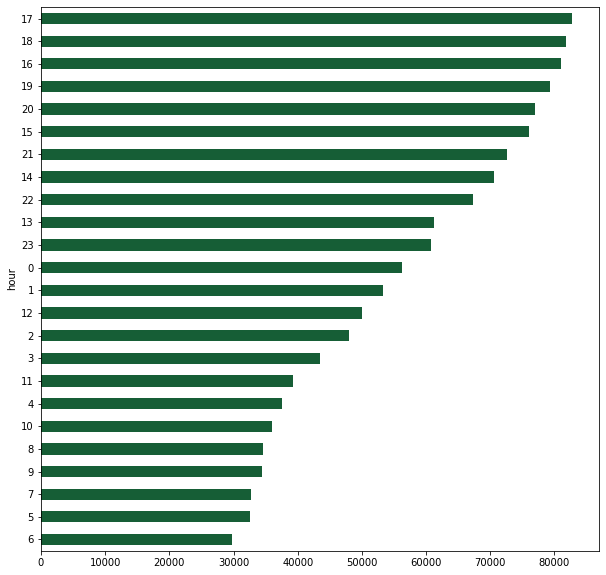

In [ ]:
df.groupby('hour').text.count().sort_values(ascending=True).plot(kind='barh',figsize=(10, 10), color='#165e36', zorder=2)

In [ ]:
df.drop(['hour'], axis=1,inplace=True)

### III. What day of the week...

In [ ]:
def extractDay(string):
    index = datetime.strptime(string, '%a %b %d %H:%M:%S %z %Y').weekday()
    if index == 0:
        return 'Mon'
    elif index == 1:
        return 'Tue'
    elif index == 2:
        return 'Wed'
    elif index == 3:
        return 'Thu'
    elif index == 4:
        return 'Fri'
    elif index == 5:
        return 'Sat'
    else:
        return 'Sun'

In [ ]:
df['day'] = df.time.apply(lambda x: extractDay(x))

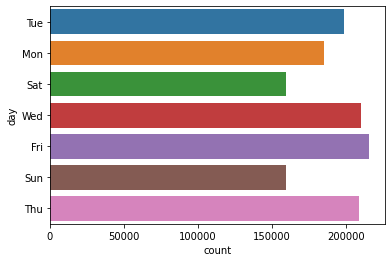

In [ ]:
sns.countplot(y='day', data=df)

In [ ]:
df.drop(['day'], axis=1,inplace=True)

### IV. Average tweet response time for all the companies

In [ ]:
#In order to calculate average Tweet response times by companies, we do not require preprocessing hence loading the data file again and focusing on tweet creation and response times
tweets_raw = pd.read_csv("/content/drive/Shared drives/NLP/Project/twcs2.csv", low_memory=False)

In [ ]:
#Understanding the size of the original dataframe
tweets_raw.shape

(2811774, 7)

In [ ]:
#Getting info about the datafram
tweets_raw.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2811774 entries, 0 to 2811773
Data columns (total 7 columns):
 #   Column                   Dtype  
---  ------                   -----  
 0   tweet_id                 int64  
 1   author_id                object 
 2   inbound                  bool   
 3   created_at               object 
 4   text                     object 
 5   response_tweet_id        object 
 6   in_response_to_tweet_id  float64
dtypes: bool(1), float64(1), int64(1), object(4)
memory usage: 131.4+ MB


In [ ]:
tweets_raw.head()

,tweet_id,author_id,inbound,created_at,text,response_tweet_id,in_response_to_tweet_id
0,1,sprintcare,False,Tue Oct 31 22:10:47 +0000 2017,@115712 I understand. I would like to assist y...,2,3.0
1,2,115712,True,Tue Oct 31 22:11:45 +0000 2017,@sprintcare and how do you propose we do that,NaN,1.0
2,3,115712,True,Tue Oct 31 22:08:27 +0000 2017,@sprintcare I have sent several private messag...,1,4.0
3,4,sprintcare,False,Tue Oct 31 21:54:49 +0000 2017,@115712 Please send us a Private Message so th...,3,5.0
4,5,115712,True,Tue Oct 31 21:49:35 +0000 2017,@sprintcare I did.,4,6.0


In [ ]:
#Separating the original dataframe into inbounds and outbounds
inbounds = tweets_raw.loc[tweets_raw['inbound'] == True]
outbounds = tweets_raw.loc[tweets_raw['inbound'] == False]

#Merging/joining to be able to later find time between responses. Messy as a variable because the table looks so messy.
messy = pd.merge(outbounds, inbounds, left_on='in_response_to_tweet_id', right_on='tweet_id', how='outer')

#Changing timestamp format
messy['outbound_time'] = pd.to_datetime(messy['created_at_x'], format='%a %b %d %H:%M:%S +0000 %Y')
messy['inbound_time'] = pd.to_datetime(messy['created_at_y'], format='%a %b %d %H:%M:%S +0000 %Y')

#Calculating time between between outbound response and inbound message
messy['response_time'] = messy['outbound_time'] - messy['inbound_time']

messy.head()

,tweet_id_x,author_id_x,inbound_x,created_at_x,text_x,response_tweet_id_x,in_response_to_tweet_id_x,tweet_id_y,author_id_y,inbound_y,created_at_y,text_y,response_tweet_id_y,in_response_to_tweet_id_y,outbound_time,inbound_time,response_time
0,1.0,sprintcare,False,Tue Oct 31 22:10:47 +0000 2017,@115712 I understand. I would like to assist y...,2,3.0,3.0,115712,True,Tue Oct 31 22:08:27 +0000 2017,@sprintcare I have sent several private messag...,1,4.0,2017-10-31 22:10:47,2017-10-31 22:08:27,0 days 00:02:20
1,4.0,sprintcare,False,Tue Oct 31 21:54:49 +0000 2017,@115712 Please send us a Private Message so th...,3,5.0,5.0,115712,True,Tue Oct 31 21:49:35 +0000 2017,@sprintcare I did.,4,6.0,2017-10-31 21:54:49,2017-10-31 21:49:35,0 days 00:05:14
2,6.0,sprintcare,False,Tue Oct 31 21:46:24 +0000 2017,@115712 Can you please send us a private messa...,"5,7",8.0,8.0,115712,True,Tue Oct 31 21:45:10 +0000 2017,@sprintcare is the worst customer service,"9,6,10",NaN,2017-10-31 21:46:24,2017-10-31 21:45:10,0 days 00:01:14
3,9.0,sprintcare,False,Tue Oct 31 21:46:14 +0000 2017,@115712 I would love the chance to review the ...,NaN,8.0,8.0,115712,True,Tue Oct 31 21:45:10 +0000 2017,@sprintcare is the worst customer service,"9,6,10",NaN,2017-10-31 21:46:14,2017-10-31 21:45:10,0 days 00:01:04
4,10.0,sprintcare,False,Tue Oct 31 21:45:59 +0000 2017,@115712 Hello! We never like our customers to ...,NaN,8.0,8.0,115712,True,Tue Oct 31 21:45:10 +0000 2017,@sprintcare is the worst customer service,"9,6,10",NaN,2017-10-31 21:45:59,2017-10-31 21:45:10,0 days 00:00:49


In [ ]:
#Making sure the data type is a timedelta/duration
print('from ' + str(messy['response_time'].dtype))

#Making it easier to later do averages by converting to a float datatype
messy['converted_time'] = messy['response_time'].astype('timedelta64[s]') / 60

print('to ' + str(messy['converted_time'].dtype))

from timedelta64[ns]
to float64


In [ ]:
# Getting the average response time per company for the Top 35 companies with shortest response time
messy.groupby('author_id_x')['converted_time'].mean().nsmallest(35)

author_id_x
VerizonSupport       7.742148
LondonMidland        8.643067
nationalrailenq      9.715906
AlaskaAir           10.566140
TMobileHelp         12.037595
VirginAmerica       13.266661
TwitterSupport      16.584870
VirginTrains        18.048609
AmericanAir         20.273799
SW_Help             20.411553
PearsonSupport      22.761882
mediatemplehelp     26.494702
SouthwestAir        30.188707
Postmates_Help      33.907324
IHGService          40.441816
AmazonHelp          40.899739
GWRHelp             40.981293
VirginAtlantic      43.195461
AskTigogh           43.425923
AskLyft             46.520775
UPSHelp             47.121729
ChipotleTweets      47.965081
ArgosHelpers        52.103771
CoxHelp             52.756280
Safaricom_Care      56.190680
Ask_Spectrum        61.147484
AskPapaJohns        65.647229
JetBlue             74.324801
sprintcare          78.412310
USCellularCares     81.812166
askpanera           82.058744
Uber_Support        94.840868
AirbnbHelp          99.75775

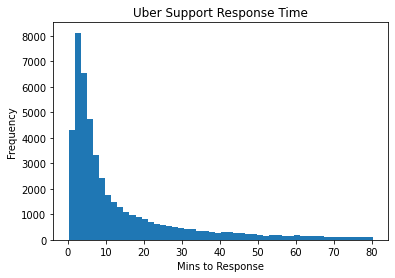

Uber's average response time is 13.76 minutes.


In [ ]:
#Focusing in on Uber and some well known companies and taking out outliers to look at average tweet response times for these companies

Uber = messy[messy['author_id_x'] == 'Uber_Support']
uber_times = Uber['converted_time']

uber_times.dropna()

def remove_outlier(uber_times):
    q1 = uber_times.quantile(0.25)
    q3 = uber_times.quantile(0.75)
    iqr = q3-q1 #Interquartile range
    fence_low  = q1-1.5*iqr
    fence_high = q3+1.5*iqr
    df_out = uber_times.loc[(uber_times > fence_low) & (uber_times < fence_high)]
    return df_out

no_outliers = remove_outlier(uber_times)

import matplotlib.pyplot as plt
hist_plot = no_outliers.plot.hist(bins=50)
hist_plot.set_title('Uber Support Response Time')
hist_plot.set_xlabel('Mins to Response')
hist_plot.set_ylabel('Frequency')
plt.show()

print('Uber\'s average response time is ' + str(round(no_outliers.mean(),2)) + ' minutes.' )

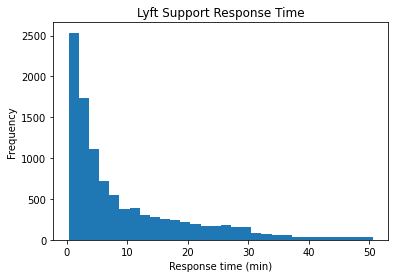

Lyft's average response time is 9.44 minutes.


In [ ]:
#AskLyft

lyft = messy[messy['author_id_x'] == 'AskLyft']
lyft_times = lyft['converted_time']
lyft_times.dropna()

def remove_outlier(lyft_times):
    q1 = lyft_times.quantile(0.25)
    q3 = lyft_times.quantile(0.75)
    iqr = q3-q1 #Interquartile range
    fence_low  = q1-1.5*iqr
    fence_high = q3+1.5*iqr
    df_out = lyft.loc[(lyft_times > fence_low) & (lyft_times < fence_high)]
    return df_out


lyft_no_outliers = remove_outlier(lyft_times)

import matplotlib.pyplot as plt
hist_plot = lyft_no_outliers['converted_time'].plot.hist(bins=30)
hist_plot.set_title('Lyft Support Response Time')
hist_plot.set_xlabel('Response time (min)')
hist_plot.set_ylabel('Frequency')
plt.show()

print('Lyft\'s average response time is ' + str(round(lyft_no_outliers['converted_time'].mean(),2)) + ' minutes.' )

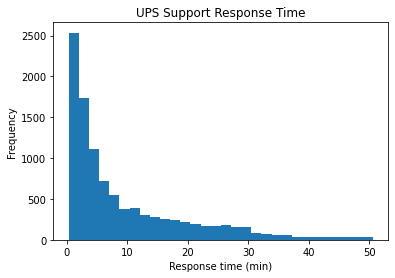

UPS's average response time is 14.7 minutes.


In [ ]:
#UPSHelp

ups = messy[messy['author_id_x'] == 'UPSHelp']
ups_times = ups['converted_time']
ups_times.dropna()

def remove_outlier(ups_times):
    q1 = ups_times.quantile(0.25)
    q3 = ups_times.quantile(0.75)
    iqr = q3-q1 #Interquartile range
    fence_low  = q1-1.5*iqr
    fence_high = q3+1.5*iqr
    df_out = ups.loc[(ups_times > fence_low) & (ups_times < fence_high)]
    return df_out


ups_no_outliers = remove_outlier(ups_times)

import matplotlib.pyplot as plt
hist_plot = lyft_no_outliers['converted_time'].plot.hist(bins=30)
hist_plot.set_title('UPS Support Response Time')
hist_plot.set_xlabel('Response time (min)')
hist_plot.set_ylabel('Frequency')
plt.show()

print('UPS\'s average response time is ' + str(round(ups_no_outliers['converted_time'].mean(),2)) + ' minutes.' )

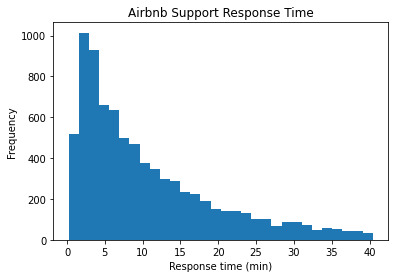

Airbnb's average response time is 10.53 minutes.


In [ ]:
#AirbnbHelp

airbnb = messy[messy['author_id_x'] == 'AirbnbHelp']
airbnb_times = airbnb['converted_time']
airbnb_times.dropna()

def remove_outlier(airbnb_times):
    q1 = airbnb_times.quantile(0.25)
    q3 = airbnb_times.quantile(0.75)
    iqr = q3-q1 #Interquartile range
    fence_low  = q1-1.5*iqr
    fence_high = q3+1.5*iqr
    df_out = airbnb.loc[(airbnb_times > fence_low) & (airbnb_times < fence_high)]
    return df_out


airbnb_no_outliers = remove_outlier(airbnb_times)

import matplotlib.pyplot as plt
hist_plot = airbnb_no_outliers['converted_time'].plot.hist(bins=30)
hist_plot.set_title('Airbnb Support Response Time')
hist_plot.set_xlabel('Response time (min)')
hist_plot.set_ylabel('Frequency')
plt.show()

print('Airbnb\'s average response time is ' + str(round(airbnb_no_outliers['converted_time'].mean(),2)) + ' minutes.' )

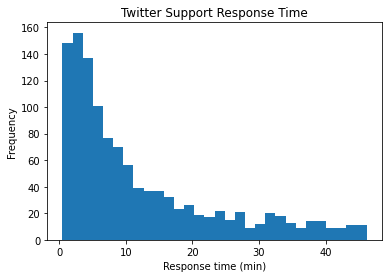

Twitter's average response time is 12.03 minutes.


In [ ]:
#TwitterSupport

twitter = messy[messy['author_id_x'] == 'TwitterSupport']
twitter_times = twitter['converted_time']
twitter_times.dropna()

def remove_outlier(twitter_times):
    q1 = twitter_times.quantile(0.25)
    q3 = twitter_times.quantile(0.75)
    iqr = q3-q1 #Interquartile range
    fence_low  = q1-1.5*iqr
    fence_high = q3+1.5*iqr
    df_out = twitter.loc[(twitter_times > fence_low) & (twitter_times < fence_high)]
    return df_out


twitter_no_outliers = remove_outlier(twitter_times)

import matplotlib.pyplot as plt
hist_plot = twitter_no_outliers['converted_time'].plot.hist(bins=30)
hist_plot.set_title('Twitter Support Response Time')
hist_plot.set_xlabel('Response time (min)')
hist_plot.set_ylabel('Frequency')
plt.show()

print('Twitter\'s average response time is ' + str(round(twitter_no_outliers['converted_time'].mean(),2)) + ' minutes.' )

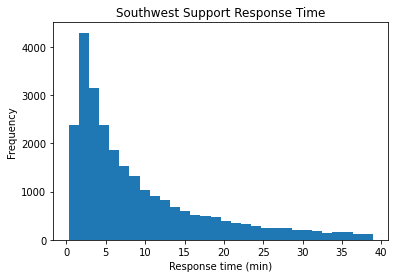

Southwest's average response time is 9.1 minutes.


In [ ]:
#SouthwestAirSupport

southwest = messy[messy['author_id_x'] == 'SouthwestAir']
southwest_times = southwest['converted_time']
southwest_times.dropna()

def remove_outlier(southwest_times):
    q1 = southwest_times.quantile(0.25)
    q3 = southwest_times.quantile(0.75)
    iqr = q3-q1 #Interquartile range
    fence_low  = q1-1.5*iqr
    fence_high = q3+1.5*iqr
    df_out = southwest.loc[(southwest_times > fence_low) & (southwest_times < fence_high)]
    return df_out


southwest_no_outliers = remove_outlier(southwest_times)

import matplotlib.pyplot as plt
hist_plot = southwest_no_outliers['converted_time'].plot.hist(bins=30)
hist_plot.set_title('Southwest Support Response Time')
hist_plot.set_xlabel('Response time (min)')
hist_plot.set_ylabel('Frequency')
plt.show()

print('Southwest\'s average response time is ' + str(round(southwest_no_outliers['converted_time'].mean(),2)) + ' minutes.' )

# D. Sentiment Analysis for Airline and Transportation Companies

In [ ]:
df.type.value_counts()

company      672923
inbound      472360
responses    193023
Name: type, dtype: int64

In [ ]:
df.company.value_counts().head(20)

AppleSupport       126548
AmazonHelp         119119
Uber_Support        72493
AmericanAir         49275
SpotifyCares        47681
comcastcares        46237
Delta               45289
Tesco               43762
TMobileHelp         36552
SouthwestAir        36311
British_Airways     34050
Ask_Spectrum        32177
UPSHelp             27431
sprintcare          25770
hulu_support        24748
VirginTrains        23841
XboxSupport         22586
AskTarget           20968
GWRHelp             19966
ATVIAssist          19600
Name: company, dtype: int64

#### Airline Company Sentiment

In [ ]:
#Extract only Airline Complaints
airlinesQnR = df[(df["company"]=="AmericanAir")|(df["company"]=="British_Airways")|(df["company"]=="SouthwestAir") | (df["company"]=="Delta") ]
airlinesQnR.company.value_counts()

AmericanAir        49275
Delta              45289
SouthwestAir       36311
British_Airways    34050
Name: company, dtype: int64

In [ ]:
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

##### **Observations**
- **American airlines** has the **most negative average sentiment for inbound tweets** out of all four companies.
- **Southwest airlines** has the **most positive average sentiment for inbound tweets**.
- **Southwest airlines** also has the **most positive average sentiment for its company response tweets**.
- The **British Airways customers have the highest positive change in sentiment after interactive with the company**.



**American Air**

In [ ]:
american_air = airlinesQnR[airlinesQnR['company'] == 'AmericanAir']
print('Initial Tweet Sentiment', round(american_air[american_air['type'] == 'inbound'].sent.mean(),4))
print(' ')
print('Change in Sentiment after interacting with company', \
      round(american_air[american_air['type'] == 'responses'].sent.mean() - american_air[american_air['type'] == 'inbound'].sent.mean(),4))
print(' ')
print('Company Tweet sentiment', round(american_air[american_air['type'] == 'company'].sent.mean(),4))

Initial Tweet Sentiment 0.0215
 
Change in Sentiment after interacting with company 0.0429
 
Company Tweet sentiment 0.4032


**British Airways**

In [ ]:
british_air = airlinesQnR[airlinesQnR['company'] == 'British_Airways']
print('Initial Tweet Sentiment',round(british_air[british_air['type'] == 'inbound'].sent.mean(),4))
print(' ')
print('Change in Sentiment after interacting with company', \
      round(british_air[british_air['type'] == 'responses'].sent.mean() - british_air[british_air['type'] == 'inbound'].sent.mean(),4))
print(' ')
print('Company Tweet sentiment', round(british_air[british_air['type'] == 'company'].sent.mean(),4))

Initial Tweet Sentiment 0.0553
 
Change in Sentiment after interacting with company 0.0426
 
Company Tweet sentiment 0.2621


**Southwest Air**

In [ ]:
southwest_air = airlinesQnR[airlinesQnR['company'] == 'SouthwestAir']
print('Initial Tweet Sentiment', round(southwest_air[southwest_air['type'] == 'inbound'].sent.mean(),4))
print(' ')
print('Change in Sentiment after interacting with company', \
      round(southwest_air[southwest_air['type'] == 'responses'].sent.mean() - southwest_air[southwest_air['type'] == 'inbound'].sent.mean(),4))
print(' ')
print('Company Tweet sentiment', round(southwest_air[southwest_air['type'] == 'company'].sent.mean(),4))

Initial Tweet Sentiment 0.1867
 
Change in Sentiment after interacting with company 0.0376
 
Company Tweet sentiment 0.4692


**Delta**

In [ ]:
delta_air = airlinesQnR[airlinesQnR['company'] == 'Delta']
print('Initial Tweet Sentiment', round(delta_air[delta_air['type'] == 'inbound'].sent.mean(),4))
print(' ')
print('Change in Sentiment after interacting with company', \
      round(delta_air[delta_air['type'] == 'responses'].sent.mean() - delta_air[delta_air['type'] == 'inbound'].sent.mean(),4))
print(' ')
print('Company Tweet sentiment', round(delta_air[delta_air['type'] == 'company'].sent.mean(),4))

Initial Tweet Sentiment 0.1174
 
Change in Sentiment after interacting with company 0.0164
 
Company Tweet sentiment 0.4005


#### Transportation Company Sentiment

In [ ]:
CabsQnR = df[(df["company"]=="AskLyft")|(df["company"]=="Uber_Support")]
CabsQnR.company.value_counts()

Uber_Support    72493
AskLyft         16189
Name: company, dtype: int64

##### **Observations**
- Lyft has the lower average sentiment for inbound tweets.
- Lyft's customers have the highest positive change in sentiment after interacting with the company.
- Lyft's company tweets have the highest average sentiment.

**Uber**

In [ ]:
uber = CabsQnR[CabsQnR['company'] == 'Uber_Support']
print('Initial Tweet Sentiment', round(uber[uber['type'] == 'inbound'].sent.mean(),4))
print(' ')
print('Change in Sentiment after interacting with company', \
      round(uber[uber['type'] == 'responses'].sent.mean() - uber[uber['type'] == 'inbound'].sent.mean(),4))
print(' ')
print('Company Tweet sentiment', round(uber[uber['type'] == 'company'].sent.mean(),4))

Initial Tweet Sentiment -0.1022
 
Change in Sentiment after interacting with company 0.1276
 
Company Tweet sentiment 0.3608


**Lyft**

In [ ]:
lyft = CabsQnR[CabsQnR['company'] == 'AskLyft']
print('Initial Tweet Sentiment', round(lyft[lyft['type'] == 'inbound'].sent.mean(), 4))
print(' ')
print('Change in Sentiment after interacting with company', \
      round(lyft[lyft['type'] == 'responses'].sent.mean() - lyft[lyft['type'] == 'inbound'].sent.mean(),4))
print(' ')
print('Company Tweet sentiment', round(lyft[lyft['type'] == 'company'].sent.mean(),4))

Initial Tweet Sentiment -0.1118
 
Change in Sentiment after interacting with company 0.1531
 
Company Tweet sentiment 0.3879


# E. Latent Dirichlet Allocation Topic Modeling

- LDA for 

In [ ]:
import warnings
warnings.filterwarnings('ignore')

In [ ]:
# LDA function for Negative comments 
def lda_model(df, topics, print_top):  
  T = []
  for x in df[df['sent'] < 0].text:
      T = T + [x.split()] 
      
  dictionary = corpora.Dictionary(T)
  corpus = [dictionary.doc2bow(text) for text in T]

  lda = LdaModel(corpus, 
              id2word=dictionary, 
              num_topics=topics, 
              random_state=0, 
              iterations=100,
              passes=5,
              per_word_topics=False)

  x=lda.show_topics(num_topics=10, num_words=10,formatted=False)
  topics_words = [(tp[0], [wd[0] for wd in tp[1]]) for tp in x]

  #Below Code Prints Topics and Words
  if print_top == True:
    for topic,words in topics_words:
        print(str(topic)+ "::"+ str(words))

  #Creating an unvectorized corpus for the coherence score function    
  text = [[dictionary[word_id] for word_id, freq in doc] for doc in corpus]


  return lda, dictionary, corpus, text

In [ ]:
uber_lda, uber_dict, uber_corpus, uber_text = lda_model(uber, 6, True)

0::['uber', 'driver', 'note', 'help', 'phone', 'account', 'need', 'number', 'get', 'cant']
1::['driver', 'uber', 'trip', 'cab', 'cancel', 'ride', 'take', 'cancelled', 'pick', 'drop']
2::['order', 'response', 'time', 'service', 'already', 'hour', 'still', 'food', 'customer', 'get']
3::['driver', 'charged', 'ride', 'uber', 'get', 'got', 'time', 'charge', 'trip', 'money']
4::['sorry', 'email', 'message', 'hear', 'send', 'trouble', 'address', 'please', 'well', 'via']
5::['connect', 'support', 'dont', 'link', 'issue', 'phone', 'app', 'assist', 'offer', 'apologize']


### Coherence Score

For Coherence score C_V, the higher the better \
https://www.machinelearningplus.com/nlp/topic-modeling-gensim-python/

https://stackoverflow.com/questions/46282473/error-while-identify-the-coherence-value-from-lda-model

In [ ]:
def coherence_graph(df, show_topics, max_topics, title):
  coherence_values = []

  for i in range(2, max_topics + 1):
    lda, diction, corpus, text = lda_model(df, i, show_topics)
    cm = CoherenceModel(model=lda, corpus = corpus, dictionary = diction, texts = text, coherence='c_v')
    coherence_values.append(cm.get_coherence())

  x = range(2, max_topics + 1)
  plt.plot(x, coherence_values)
  plt.title(title)
  plt.xlabel("Num Topics")
  plt.ylabel("Coherence score")
  plt.legend(("coherence_values"), loc='best')
  plt.show()
  print(coherence_values)

#### Transportation Companies

Uber Optimal Topics: 

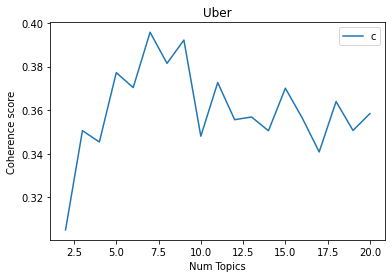

[0.30497396228796964, 0.350573650483182, 0.3453636732848033, 0.3772310857643219, 0.3703704718439487, 0.3957888507285751, 0.38150750940839495, 0.3921905280075035, 0.34803301700129036, 0.37266679419369697, 0.35561122352650987, 0.356853992153465, 0.3505318070510847, 0.37007092157556265, 0.3563518391623426, 0.3408043141987212, 0.36395195445455386, 0.3506737813520986, 0.3584167822569714]


In [ ]:
coherence_graph(uber[uber['type'] == 'inbound'], False, 20, 'Uber')

Lyft Optimal Topics: 

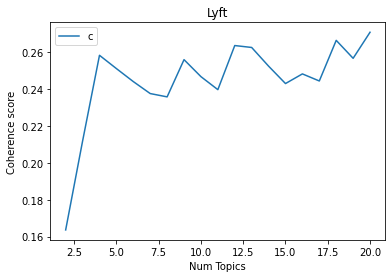

[0.16363646341642632, 0.21177247148530523, 0.25831460523524635, 0.2511153722109066, 0.24406326420932803, 0.23756884946816018, 0.23577121813583768, 0.25595528506601634, 0.2467401664512952, 0.2396854281194732, 0.2636055203797068, 0.26256126848389194, 0.25243612371390123, 0.24299461942736614, 0.24822901577631962, 0.2443952847859258, 0.2664174903268176, 0.2566871401376008, 0.2708151919045692]


In [ ]:
coherence_graph(lyft[lyft['type'] == 'inbound'], False, 20, 'Lyft')

#### Airline Companies

British Air Optimal Topics: 

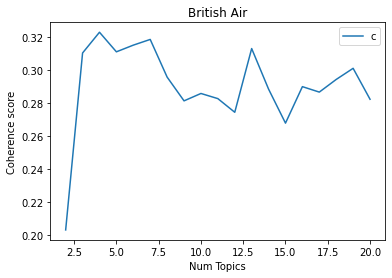

[0.20337630090869335, 0.31041356449124013, 0.3229578073749644, 0.31111247886413973, 0.3151556114634447, 0.31860688164388734, 0.2958266835892761, 0.28144979150409855, 0.28591511712331724, 0.28280496978018593, 0.27454606923472424, 0.3130879205342001, 0.2885493916258014, 0.26797629348387786, 0.29004839223873047, 0.2867476009247748, 0.29440455946100635, 0.3011379269511855, 0.28241381289942247]


In [ ]:
coherence_graph(british_air[british_air['type'] == 'inbound'], False, 20, 'British Air')

American Air Optimal Topics: 

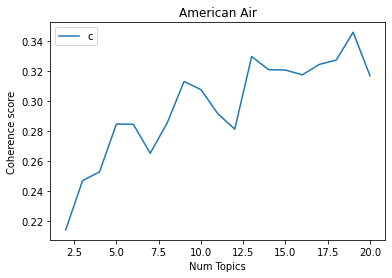

[0.21394612203497843, 0.24682191652003813, 0.2525969248052611, 0.2845425250238175, 0.2844173466435073, 0.2650604542472223, 0.28517759065697834, 0.3129180770601288, 0.30751216690859395, 0.2913865495564811, 0.28114026961928607, 0.3296018469828673, 0.32080864790640534, 0.3205488727745221, 0.31735177206396514, 0.3243134706169982, 0.32717946871586734, 0.34575654903989905, 0.3166827460811125]


In [ ]:
coherence_graph(american_air[american_air['type'] == 'inbound'], False, 20, 'American Air')

Delta Air Optimal Topics:

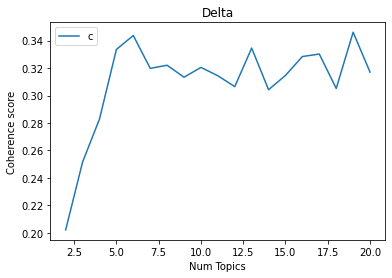

[0.20218905199045345, 0.2515975748999694, 0.28285027946933433, 0.3335117084119984, 0.3436562390083198, 0.31977193776738444, 0.3220116407141096, 0.3133110332278436, 0.32045001541472046, 0.314367759294165, 0.3064677317753593, 0.3345039408663905, 0.3042231896422534, 0.31462575131862097, 0.32837678678840493, 0.33016598612351666, 0.3051349696943453, 0.34604027500243956, 0.31701258481313466]


In [ ]:
coherence_graph(delta_air[delta_air['type'] == 'inbound'], False, 20, 'Delta')

Southwest Air Optimal Topics: 

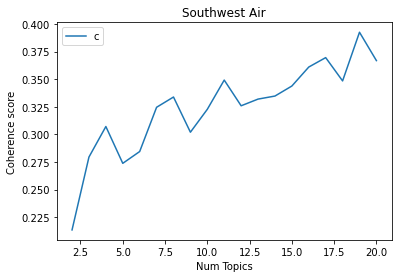

[0.21337541985040667, 0.2794377516784589, 0.3071190782730609, 0.2737497019126753, 0.284445999767151, 0.32456639392003955, 0.33387182257272563, 0.30196439467374586, 0.32273780557801734, 0.3492353674033774, 0.3259278746610667, 0.3319897371936492, 0.3347502026507298, 0.34384053414870647, 0.3610534284103656, 0.3696016121932457, 0.3484861674758042, 0.39260458144185373, 0.3668908412620696]


In [ ]:
coherence_graph(southwest_air[southwest_air['type'] == 'inbound'], False, 20, 'Southwest Air')

### Visualization

#### **Example |** British Airways: Inbound Tweet Topics
- The optimum LDA is at 4 topics, with the highest coherence score of 0.38

**Topics**, Largest to smallest:

0. Flights getting delayed around 1 hour or cancelled 
1. Booking problems and errors on their website and app 
2. Boarding situation and service

In [ ]:
brit_lda,brit_dict, brit_corpus, brit_text = lda_model(british_air[british_air['type'] == 'inbound'], 4, True)

0::['service', 'customer', 'seat', 'flight', 'get', 'boarding', 'flying', 'time', 'ever', 'hour']
1::['flight', 'trying', 'problem', 'booking', 'error', 'website', 'get', 'online', 'change', 'book']
2::['flight', 'hour', 'delayed', 'cancelled', 'ba', 'still', 'time', 'get', 'waiting', 'week']
3::['service', 'flight', 'customer', 'bag', 'staff', 'really', 'poor', 'check', 'seat', 'lounge']


In [ ]:
cm = CoherenceModel(model=brit_lda, corpus = brit_corpus, dictionary = brit_dict, texts = brit_text, coherence='c_v')
coherence = cm.get_coherence()
coherence

0.3229578073749644

In [ ]:
%matplotlib inline

pyLDAvis.enable_notebook()
vis = pyLDAvis.gensim.prepare(brit_lda, brit_corpus, dictionary=brit_lda.id2word)
vis

PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
2     -0.055039  0.047993       1        1  33.640560
1     -0.113815 -0.013664       2        1  28.459980
0      0.063802 -0.113765       3        1  19.364751
3      0.105052  0.079436       4        1  18.534709, topic_info=              Term         Freq        Total Category  logprob  loglift
21         service   424.000000   424.000000  Default  30.0000  30.0000
13        customer   336.000000   336.000000  Default  29.0000  29.0000
96           error   147.000000   147.000000  Default  28.0000  28.0000
50         problem   178.000000   178.000000  Default  27.0000  27.0000
53          trying   233.000000   233.000000  Default  26.0000  26.0000
434        delayed   271.000000   271.000000  Default  25.0000  25.0000
15          flight  1593.000000  1593.000000  Default  24.0000  24.0000
195           hour   320.000000   320.000000  Default  23.0000  23.0000
560        getting   116.000000   116.000000  Default  22.0000  22.0000
283          staff   161.000000   161.000000  Default  21.0000  21.0000
44          online   160.000000   160.000000  Default  20.0000  20.0000
242        booking   254.000000   254.000000  Default  19.0000  19.0000
212         lounge    85.000000    85.000000  Default  18.0000  18.0000
291           seat   346.000000   346.000000  Default  17.0000  17.0000
299         really   126.000000   126.000000  Default  16.0000  16.0000
20            poor   119.000000   119.000000  Default  15.0000  15.0000
240        website   194.000000   194.000000  Default  14.0000  14.0000
88             bag   234.000000   234.000000  Default  13.0000  13.0000
436       boarding   107.000000   107.000000  Default  12.0000  12.0000
17            keep   101.000000   101.000000  Default  11.0000  11.0000
123      cancelled   252.000000   252.000000  Default  10.0000  10.0000
2             ever    85.000000    85.000000  Default   9.0000   9.0000
166     absolutely    52.000000    52.000000  Default   8.0000   8.0000
331          worst    85.000000    85.000000  Default   7.0000   7.0000
191            ago    75.000000    75.000000  Default   6.0000   6.0000
46            book   164.000000   164.000000  Default   5.0000   5.0000
77           check   202.000000   202.000000  Default   4.0000   4.0000
10         british    44.000000    44.000000  Default   3.0000   3.0000
303         change   171.000000   171.000000  Default   2.0000   2.0000
110            say   123.000000   123.000000  Default   1.0000   1.0000
1243        nearly    27.402859    28.218794   Topic1  -6.3792   1.0601
930         second    19.968911    20.888463   Topic1  -6.6957   1.0444
1480        mobile    16.388714    17.229412   Topic1  -6.8933   1.0394
191            ago    71.802499    75.509215   Topic1  -5.4160   1.0391
1970     scheduled    12.796696    13.467688   Topic1  -7.1407   1.0383
353       birthday    14.494053    15.294215   Topic1  -7.0162   1.0357
771         logged    14.265421    15.070186   Topic1  -7.0321   1.0346
222            ref    32.330297    34.159238   Topic1  -6.2139   1.0344
1701          four     9.890806    10.555772   Topic1  -7.3983   1.0244
1896       unhappy     9.891080    10.556641   Topic1  -7.3983   1.0243
2705          stay     9.772370    10.449870   Topic1  -7.4103   1.0224
619      reference    15.801674    16.903527   Topic1  -6.9298   1.0220
3633          head    10.267145    10.985087   Topic1  -7.3609   1.0218
1685          zero     9.259688     9.911373   Topic1  -7.4642   1.0214
1568          none     9.122379     9.802854   Topic1  -7.4792   1.0175
1098         blame     8.067534     8.724995   Topic1  -7.6020   1.0111
1551        behind     8.151397     8.829886   Topic1  -7.5917   1.0095
121       transfer    21.443579    23.280017   Topic1  -6.6245   1.0073
618       november     8.724573     9.474058   Topic1  -7.5238   1.0070
1147       deliver     7.429285  

#### **Example |** Uber: Inbound Tweet Topics
- The optimum LDA is at 7 topics, with the highest coherence score of 0.39

**Topics**, Largest to smallest:




In [ ]:
uber_lda, uber_dict, uber_corpus, uber_text = lda_model(uber[uber['type'] == 'inbound'], 7, True)

0::['driver', 'car', 'uber', 'wrong', 'way', 'direction', 'getting', 'got', 'map', 'know']
1::['charged', 'driver', 'ride', 'trip', 'uber', 'refund', 'got', 'money', 'cancelled', 'never']
2::['order', 'food', 'hour', 'ordered', 'service', 'time', 'wrong', 'delivery', 'ubereats', 'delivered']
3::['driver', 'uber', 'take', 'time', 'stop', 'one', 'drive', 'worst', 'going', 'i’m']
4::['uber', 'phone', 'customer', 'service', 'account', 'number', 'app', 'email', 'contact', 'help']
5::['driver', 'cancel', 'ride', 'uber', 'min', 'trip', 'charged', 'minute', 'time', 'charge']
6::['keep', 'account', 'card', 'use', 'uber', 'time', 'error', 'app', 'payment', 'getting']


In [ ]:
cm = CoherenceModel(model=uber_lda, corpus = uber_corpus, dictionary = uber_dict, texts = uber_text, coherence='c_v')
coherence = cm.get_coherence()
coherence

0.3957888507285751

In [ ]:
%matplotlib inline

pyLDAvis.enable_notebook()
vis = pyLDAvis.gensim.prepare(uber_lda, uber_corpus, dictionary=uber_lda.id2word)
vis

PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
5     -0.101149  0.076799       1        1  25.035353
4      0.132547 -0.014597       2        1  17.857383
1     -0.043496  0.107080       3        1  16.850851
0     -0.177800 -0.044708       4        1  11.767681
2      0.120436  0.203288       5        1  10.900248
6      0.226406 -0.181369       6        1   9.049802
3     -0.156944 -0.146494       7        1   8.538681, topic_info=                 Term         Freq        Total Category  logprob  loglift
7               order  1437.000000  1437.000000  Default  30.0000  30.0000
82            charged  2543.000000  2543.000000  Default  29.0000  29.0000
13             driver  6526.000000  6526.000000  Default  28.0000  28.0000
67             cancel  1402.000000  1402.000000  Default  27.0000  27.0000
20               food   740.000000   740.000000  Default  26.0000  26.0000
194              trip  1656.000000  1656.000000  Default  25.0000  25.0000
176           account  1186.000000  1186.000000  Default  24.0000  24.0000
29              phone   923.000000   923.000000  Default  23.0000  23.0000
74                min   953.000000   953.000000  Default  22.0000  22.0000
89                car  1001.000000  1001.000000  Default  21.0000  21.0000
128            number   601.000000   601.000000  Default  20.0000  20.0000
161             email   579.000000   579.000000  Default  19.0000  19.0000
179              hour   584.000000   584.000000  Default  18.0000  18.0000
15             refund   757.000000   757.000000  Default  17.0000  17.0000
56               ride  2270.000000  2270.000000  Default  16.0000  16.0000
46           customer  1134.000000  1134.000000  Default  15.0000  15.0000
205              time  1649.000000  1649.000000  Default  14.0000  14.0000
85            ordered   481.000000   481.000000  Default  13.0000  13.0000
45            contact   612.000000   612.000000  Default  12.0000  12.0000
49            service  1464.000000  1464.000000  Default  11.0000  11.0000
249              keep   356.000000   356.000000  Default  10.0000  10.0000
129             wrong   915.000000   915.000000  Default   9.0000   9.0000
130         cancelled  1182.000000  1182.000000  Default   8.0000   8.0000
286              card   431.000000   431.000000  Default   7.0000   7.0000
251               use   471.000000   471.000000  Default   6.0000   6.0000
55              money   662.000000   662.000000  Default   5.0000   5.0000
288             never   736.000000   736.000000  Default   4.0000   4.0000
487             error   276.000000   276.000000  Default   3.0000   3.0000
135            minute   817.000000   817.000000  Default   2.0000   2.0000
224          delivery   296.000000   296.000000  Default   1.0000   1.0000
67             cancel  1401.233765  1402.763001   Topic1  -3.5481   1.3838
432              book   257.948595   258.689977   Topic1  -5.2404   1.3820
108           booking   150.857306   151.608285   Topic1  -5.7768   1.3799
634           showing   125.372096   126.120201   Topic1  -5.9619   1.3789
411              toll   104.400846   105.141573   Topic1  -6.1449   1.3778
217        cancelling   177.379568   178.882374   Topic1  -5.6149   1.3764
429              mins    88.387816    89.172510   Topic1  -6.3114   1.3760
886                 ₹    59.488653    60.234892   Topic1  -6.7074   1.3724
2830           quoted    57.680502    58.420788   Topic1  -6.7382   1.3721
1725              ola    56.839252    57.581993   Topic1  -6.7529   1.3719
631          schedule    54.449224    55.192930   Topic1  -6.7959   1.3713
1341         estimate    50.617117    51.382574   Topic1  -6.8689   1.3699
2602         provided    46.851128    47.600168   Topic1  -6.9462   1.3690
994              fact    46.134246    46.878966   Topic1  -6.9616   1.3689
2225       delivering    45.701256    46.451281   Topic1  -6.9710   1.3686
885             shown

# F. Emoji Analysis

In [ ]:
df_emoji.head()

,time,text,company,type
2,Tue Oct 31 21:45:10 +0000 2017,@sprintcare is the worst customer service,sprintcare,inbound
5,Tue Oct 31 22:03:34 +0000 2017,"@115714 whenever I contact customer support, t...",sprintcare,inbound
7,Tue Oct 31 22:06:54 +0000 2017,"Yo @Ask_Spectrum, your customer service reps a...",Ask_Spectrum,inbound
8,Tue Oct 31 22:06:56 +0000 2017,My picture on @Ask_Spectrum pretty much every ...,Ask_Spectrum,inbound
10,Tue Oct 31 22:12:16 +0000 2017,@VerizonSupport My friend is without internet ...,VerizonSupport,inbound


In [ ]:
!pip install emoji
!pip install textblob

     |████████████████████████████████| 51kB 4.3MB/s 
  Created wheel for emoji: filename=emoji-0.6.0-cp36-none-any.whl size=49716 sha256=1ae13ff8bc72bbb7d6c3356b6a3ce91c6599723ec99a5019c68cf570ad40f07f
  Stored in directory: /root/.cache/pip/wheels/46/2c/8b/9dcf5216ca68e14e0320e283692dce8ae321cdc01e73e17796
Successfully built emoji


In [ ]:
import emoji

def extract_emojis(s):
    return ''.join(c for c in s if c in emoji.UNICODE_EMOJI)

In [ ]:
df_emoji['emojis'] = df_emoji['text'].apply(lambda text: extract_emojis(text))

In [ ]:
df_emoji['emojis'].value_counts()

         1784340
😊           5169
😡           4983
🤔           3955
🙄           3548
          ...   
🙂🙂🖕🏼           1
🚗💨             1
🙇♂✨👍👍          1
🍿🍩🍪🍟           1
🤭😳             1
Name: emojis, Length: 20902, dtype: int64

In [ ]:
"""from collections import defaultdict, OrderedDict

def create_emoji_string(df):
    emoji_dict = defaultdict(int) 
    for ind in df.index:
        for each_emoji in df['emojis'][ind]:
            emoji_dict[each_emoji]+=1
    
    return OrderedDict(sorted(emoji_dict.items(), key=lambda item: item[1], reverse=True))

emoji_dict = create_emoji_string(df_emoji)"""

"from collections import defaultdict, OrderedDict\n\ndef create_emoji_string(df):\n    emoji_dict = defaultdict(int) \n    for ind in df.index:\n        for each_emoji in df['emojis'][ind]:\n            emoji_dict[each_emoji]+=1\n    \n    return OrderedDict(sorted(emoji_dict.items(), key=lambda item: item[1], reverse=True))\n\nemoji_dict = create_emoji_string(df_emoji)"

In [ ]:
"""print(emoji_dict)"""

'print(emoji_dict)'

### Lyft vs Uber & Xbox vs PlayStation

In [ ]:
"""def neg_emoji_count(emoji_dict):
  neg_emoji = 0
  for emoji in emoji_dict:
    if emoji in ('😭', '😡', '😩', '😢', '😫', '😠', '😔', '👎', '🤦', '😥'):
      neg_emoji += emoji_dict[emoji]
  return neg_emoji"""

"def neg_emoji_count(emoji_dict):\n  neg_emoji = 0\n  for emoji in emoji_dict:\n    if emoji in ('😭', '😡', '😩', '😢', '😫', '😠', '😔', '👎', '🤦', '😥'):\n      neg_emoji += emoji_dict[emoji]\n  return neg_emoji"

In [ ]:
"""# Lyft
df_lyft = df_emoji[df_emoji['company']=='AskLyft']
lyft_emoji = create_emoji_string(df_lyft)

#Uber
df_uber = df_emoji[df_emoji['company']=='Uber_Support']
uber_emoji = create_emoji_string(df_uber)"""

"# Lyft\ndf_lyft = df_emoji[df_emoji['company']=='AskLyft']\nlyft_emoji = create_emoji_string(df_lyft)\n\n#Uber\ndf_uber = df_emoji[df_emoji['company']=='Uber_Support']\nuber_emoji = create_emoji_string(df_uber)"

In [ ]:
"""# Xbox
df_xbox = df_emoji[df_emoji['company']=='XboxSupport']
xbox_emoji = create_emoji_string(df_xbox)

# PlayStation
df_ps = df_emoji[df_emoji['company']=='AskPlayStation']
ps_emoji = create_emoji_string(df_ps)"""

"# Xbox\ndf_xbox = df_emoji[df_emoji['company']=='XboxSupport']\nxbox_emoji = create_emoji_string(df_xbox)\n\n# PlayStation\ndf_ps = df_emoji[df_emoji['company']=='AskPlayStation']\nps_emoji = create_emoji_string(df_ps)"

In [ ]:
"""print((neg_emoji_count(lyft_emoji)/sum(lyft_emoji.values()))*100)"""

'print((neg_emoji_count(lyft_emoji)/sum(lyft_emoji.values()))*100)'

In [ ]:
"""print((neg_emoji_count(uber_emoji)/sum(uber_emoji.values()))*100)"""

'print((neg_emoji_count(uber_emoji)/sum(uber_emoji.values()))*100)'

In [ ]:
"""print((neg_emoji_count(ps_emoji)/sum(ps_emoji.values()))*100)"""

'print((neg_emoji_count(ps_emoji)/sum(ps_emoji.values()))*100)'

In [ ]:
"""print((neg_emoji_count(ps_emoji)/sum(xbox_emoji.values()))*100)"""

'print((neg_emoji_count(ps_emoji)/sum(xbox_emoji.values()))*100)'

### Emojis and Sentiments

In [ ]:
from textblob import TextBlob
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer

sent_analyser = SentimentIntensityAnalyzer()

def sentiment(text):
    return (sent_analyser.polarity_scores(text)["compound"] + TextBlob(text).sentiment.polarity)/2

df_emoji['text_x_sentiment'] = df_emoji['text'].apply(lambda x: sentiment(x))

In [ ]:
response_emojis_for_positive_queries = []
response_emojis_for_negative_queries = []

def sentimental_emoji(sentiment, emoji):
    if sentiment > 0.0:
        response_emojis_for_positive_queries.extend(emoji)
    elif sentiment < 0.0:
        response_emojis_for_negative_queries.extend(emoji)

In [ ]:
df_emoji.apply(lambda x: sentimental_emoji(x['text_x_sentiment'], x['emojis']), axis=1)

2         None
5         None
7         None
8         None
10        None
          ... 
279973    None
279976    None
279981    None
279986    None
279987    None
Length: 1929658, dtype: object

In [ ]:
print(Counter(response_emojis_for_positive_queries).most_common(10))

[('😂', 9334), ('😊', 7482), ('👍', 6496), ('❤', 4798), ('🏻', 4660), ('😍', 4365), ('😡', 3853), ('🏼', 3745), ('🙂', 3677), ('🤔', 2968)]


In [ ]:
print(Counter(response_emojis_for_negative_queries).most_common(10))

[('😡', 9367), ('😭', 8249), ('😩', 3742), ('🙄', 3470), ('🤔', 2393), ('😠', 2106), ('😒', 2097), ('😤', 1999), ('😢', 1943), ('🏻', 1786)]


# G. Pairwise Analysis start

#### Scattertext - a hidden gem in the Spacy Universe

Scattertext is an excellent exploratory text analysis tool, which allows  visualisations differentiating between the terms used by different documents using an interactive scatter plot.

Let's build one to compare tweet responses by American Airlines vs British Airways :


In [ ]:
cnt = Counter()
for text in df_pairwise["text"].values:
  for word in text.split():
    cnt[word] += 1
FREQWORDS = set([w for (w, wc) in cnt.most_common(10)])

In [ ]:
# df_pairwise = df.copy()

In [ ]:
df_pairwise = df_pairwise[df_pairwise['type']=='inbound']

In [ ]:
df_pairwise.head()

,time,text,company,type
2,Tue Oct 31 21:45:10 +0000 2017,@sprintcare is the worst customer service,sprintcare,inbound
5,Tue Oct 31 22:03:34 +0000 2017,"@115714 whenever I contact customer support, t...",sprintcare,inbound
7,Tue Oct 31 22:06:54 +0000 2017,"Yo @Ask_Spectrum, your customer service reps a...",Ask_Spectrum,inbound
8,Tue Oct 31 22:06:56 +0000 2017,My picture on @Ask_Spectrum pretty much every ...,Ask_Spectrum,inbound
10,Tue Oct 31 22:12:16 +0000 2017,@VerizonSupport My friend is without internet ...,VerizonSupport,inbound


In [ ]:
df_pairwise.drop(columns = ['time','type'], inplace = True)

In [ ]:
def transform_text_for_pairwise(text):

  # Preprocess Step 7: Remove Mentions
  text = ' '.join([w for w in text.split(' ') if not w.startswith('@')])

  # Preprocess Step 8: Remove Punctuation
  PUNCT_TO_REMOVE = string.punctuation
  def remove_punctuation(text):
      """custom function to remove the punctuation"""
      return text.translate(str.maketrans('', '', PUNCT_TO_REMOVE))
  text = remove_punctuation(text)

  # reference: https://www.kaggle.com/sudalairajkumar/getting-started-with-text-preprocessing
  # Pre-process Step 2 :Emoticons remove
  def remove_emoticons(text):
    pattern = re.compile(u'(' + u'|'.join(c for c in EMOTICONS) + u')')
    return pattern.sub(r'', text)
  #if LDA_clean == False:
  text = remove_emoticons(text)
    
  
  # Pre-process Step 3 : Emojis remove
  def remove_emoji(string):
    emoji_pattern = re.compile("["
                           u"\U0001F600-\U0001F64F"  # emoticons
                           u"\U0001F300-\U0001F5FF"  # symbols & pictographs
                           u"\U0001F680-\U0001F6FF"  # transport & map symbols
                           u"\U0001F1E0-\U0001F1FF"  # flags (iOS)
                           u"\U00002702-\U000027B0"
                           u"\U000024C2-\U0001F251"
                           "]+", flags=re.UNICODE)
    return emoji_pattern.sub(r'', string)
  text = remove_emoji(text)

  # Pre-process Step 4 : Chat slangs to full words      <- highlight it in presentation
  def remove_chat_words_and_contractions(string):
    new_text = []
    for word in string.split(' '):
        if word.upper() in chat_words.keys():
            new_text += chat_words[word.upper()].lower().split(' ')
        elif word.lower() in contractions.keys():
            new_text += contractions[word.lower()].split(' ')
        else:
            new_text.append(word)
    return ' '.join(new_text)
  text = remove_chat_words_and_contractions(text)

  # Preprocess Step 5 : Lowercasing
  text = text.lower()
  #df.text = df.text.apply(lambda x: lower(x))

  # Preprocess Step 6: Remove URL and HTML
  def remove_urls_HTML(text):
    url_pattern = re.compile(r'https?://\S+|www\.\S+')
    html_pattern = re.compile('<.*?>')
    text =  url_pattern.sub(r'', text)
    text = html_pattern.sub(r'', text)
    return text
  text = remove_urls_HTML(text)

  # Preprocess Step 9: Remove Stopwords
  STOPWORDS = set(stopwords.words('english'))
  def remove_stopwords(text):
    """custom function to remove the stopwords"""
    return " ".join([word for word in str(text).split() if word not in STOPWORDS])
    text = remove_stopwords(text)
 
#   if LDA_clean == True:
    # Removing words less than 3 characters
    text = ' '.join([w for w in text.split() if len(w)>= 3])

  # Preprocess Step 10: Remove Top 10 frequent words
  def remove_freqwords(text):
    return " ".join([word for word in str(text).split() if word not in FREQWORDS])    
  text = remove_freqwords(text)

  # Preprocess Step 12: Spellchecker
  #spell = SpellChecker()
  #def correct_spellings(text):
  #  corrected_text = []
  #  misspelled_words = spell.unknown(text.split())
  #  for word in text.split():
  #    if word in misspelled_words:
  #      corrected_text.append(spell.correction(word))
  #    else:
  #      corrected_text.append(word)
  #  return " ".join(corrected_text)
  #text = correct_spellings(text)

  # Preprocess Step 13: Lemmatize
  lemmatizer = WordNetLemmatizer()
  def lemmatize_words(text):
    return " ".join([lemmatizer.lemmatize(word) for word in text.split()])
  text = lemmatize_words(text)

  # Preprocess Step 14: Remove Numbers
  text = text.translate(str.maketrans('', '', '0123456789'))

  return text

In [ ]:
%%time
df_pairwise['text'] = df_pairwise['text'].apply(lambda x: transform_text_for_pairwise(x))

CPU times: user 3min 23s, sys: 10.5 s, total: 3min 33s
Wall time: 3min 33s


In [ ]:
df_pairwise.head()

,text,company
2,worst customer service,sprintcare
5,whenever i contact customer support they tell ...,sprintcare
7,yo customer service rep are super nice— but i ...,Ask_Spectrum
8,my picture on pretty much every day why should...,Ask_Spectrum
10,my friend without internet we need play videog...,VerizonSupport


In [ ]:
df_pairwise.columns = ['text','author_id_y']

#### Airline Industry

In [ ]:

#Extract only Airline Complaints
airlinesQnR = df_pairwise[(df_pairwise["author_id_y"]=="AmericanAir")|(df_pairwise["author_id_y"]=="British_Airways")]
airlinesQnR.author_id_y.value_counts()



AmericanAir        23240
British_Airways    15229
Name: author_id_y, dtype: int64

In [ ]:
import spacy

nlp = spacy.load("en_core_web_sm")

In [ ]:
%%time
# Convert complaints to Spacy Doc
airlinesQnR['parsed'] = airlinesQnR.text.apply(nlp)

CPU times: user 4min 39s, sys: 536 ms, total: 4min 40s
Wall time: 4min 40s


In [ ]:
%%time
corpus = st.CorpusFromParsedDocuments(airlinesQnR,
                             category_col='author_id_y',
                             parsed_col='parsed').build()

html = st.produce_scattertext_explorer(corpus,
          category='British_Airways',
          category_name='British Airways',
          not_category_name='American Airlines',
          width_in_pixels=800,
          minimum_term_frequency=10,
          term_significance = st.LogOddsRatioUninformativeDirichletPrior(),
          )
display(HTML(html))


CPU times: user 8.75 s, sys: 167 ms, total: 8.91 s
Wall time: 8.92 s


### Uber and Lyft Compare

In [ ]:

#Extract only Airline Complaints
CabsQnR = df_pairwise[(df_pairwise["author_id_y"]=="AskLyft")|(df_pairwise["author_id_y"]=="Uber_Support")]
CabsQnR.author_id_y.value_counts()



Uber_Support    38803
AskLyft          9698
Name: author_id_y, dtype: int64

In [ ]:
CabsQnR.columns

Index(['text', 'author_id_y'], dtype='object')

In [ ]:
%%time
CabsQnR['parsed'] = CabsQnR.text.apply(nlp)

CPU times: user 6min 14s, sys: 755 ms, total: 6min 14s
Wall time: 6min 15s


In [ ]:
%%time

corpus2 = st.CorpusFromParsedDocuments(CabsQnR,
                             category_col='author_id_y',
                             parsed_col='parsed').build()



html2 = st.produce_scattertext_explorer(corpus2,
          category='AskLyft',
          category_name='Lyft',
          not_category_name='Uber',
          width_in_pixels=800,
          minimum_term_frequency=10,
          term_significance = st.LogOddsRatioUninformativeDirichletPrior(),
          )

display(HTML(html2))

CPU times: user 11.6 s, sys: 195 ms, total: 11.8 s
Wall time: 11.8 s


### Xbox and Playstation

In [ ]:

#Extract only Airline Complaints
GamesQnR = df_pairwise[(df_pairwise["author_id_y"]=="AskPlayStation")|(df_pairwise["author_id_y"]=="XboxSupport")]
GamesQnR.author_id_y.value_counts()



XboxSupport       11235
AskPlayStation    10558
Name: author_id_y, dtype: int64

In [ ]:
GamesQnR.columns

Index(['text', 'author_id_y'], dtype='object')

In [ ]:
%%time
GamesQnR['parsed'] = GamesQnR.text.apply(nlp)

CPU times: user 2min 59s, sys: 335 ms, total: 3min
Wall time: 3min 1s


In [ ]:
%%time
corpus3 = st.CorpusFromParsedDocuments(GamesQnR,
                             category_col='author_id_y',
                             parsed_col='parsed').build()

html3 = st.produce_scattertext_explorer(corpus3,
          category='AskPlayStation',
          category_name='PlayStation',
          not_category_name='Xbox',
          width_in_pixels=800,
          minimum_term_frequency=10,
          term_significance = st.LogOddsRatioUninformativeDirichletPrior(),
          )

display(HTML(html3))

CPU times: user 6.12 s, sys: 120 ms, total: 6.24 s
Wall time: 6.25 s


### Tmobile and Sprint (American Telecom Operators)

In [ ]:

#Extract only Airline Complaints
TelecomQnR = df_pairwise[(df_pairwise["author_id_y"]=="TMobileHelp")|(df_pairwise["author_id_y"]=="sprintcare")]
TelecomQnR.author_id_y.value_counts()



TMobileHelp    20797
sprintcare     12024
Name: author_id_y, dtype: int64

In [ ]:
TelecomQnR.columns

Index(['text', 'author_id_y'], dtype='object')

In [ ]:
%%time
TelecomQnR['parsed'] = TelecomQnR.text.apply(nlp)

CPU times: user 4min 23s, sys: 460 ms, total: 4min 24s
Wall time: 4min 24s


In [ ]:
%%time
corpus4 = st.CorpusFromParsedDocuments(TelecomQnR,
                             category_col='author_id_y',
                             parsed_col='parsed').build()
html4 = st.produce_scattertext_explorer(corpus4,
          category='TMobileHelp',
          category_name='TMobile',
          not_category_name='Sprint',
          width_in_pixels=800,
          minimum_term_frequency=10,
          term_significance = st.LogOddsRatioUninformativeDirichletPrior(),
          )

display(HTML(html4))

CPU times: user 7.68 s, sys: 137 ms, total: 7.82 s
Wall time: 7.82 s
